<a href="https://colab.research.google.com/github/AaronLi43/DehazeNet/blob/master/dehazing_autoencoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm
import torchvision.transforms as T
import torch
import torch.utils as utils
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
if torch.cuda.is_available():
    device = "cuda"
else:
    device = "cpu"
print(f"# Using device: {device}")

# Using device: cuda


In [ ]:
torch.cuda.empty_cache()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
patch = np.load('/content/drive/MyDrive/patch1.npy',allow_pickle=False)
mask = np.load('/content/drive/MyDrive/hazy1.npy',allow_pickle=False)

len(patch), len(mask)
print(type(patch[1]), type(mask[1]))

<class 'numpy.ndarray'> <class 'numpy.ndarray'>


In [ ]:
patch.shape, mask.shape

((492, 256, 256, 3), (492, 256, 256, 3))

In [ ]:
# the comparison before training
for i in range(0,len(patch),20):

    fig=plt.figure(figsize=(15, 5))

    ax = plt.subplot(131)
    plt.imshow(patch[i])

    ax = plt.subplot(132)
    plt.imshow(mask[i])
    plt.show()

In [ ]:
IMG_SIZE=256

EPOCHS = 120
batch_size = 1
learning_rate = 0.0001

transform1 = T.Compose([
    T.RandomVerticalFlip(1),
    T.RandomHorizontalFlip(1),
])

transform2 = T.Compose([
    T.RandomVerticalFlip(1),

])

transform3 = T.Compose([
    T.RandomHorizontalFlip(1),
])



In [ ]:
patch_loader = torch.utils.data.DataLoader(dataset=patch,batch_size=batch_size,shuffle=False)

for data in patch_loader:
    print(data.size())
    print(type(data))
    break
print(type(patch_loader))

torch.Size([1, 256, 256, 3])
<class 'torch.Tensor'>
<class 'torch.utils.data.dataloader.DataLoader'>


In [ ]:

patch_array = np.array([patch[i] for i in range(len(patch))])
mask_array = np.array([mask[i] for i in range(len(mask))])

X_orig1=torch.Tensor([patch_array[i] for i in range(len(patch_array))])
X_hazy1=torch.Tensor([mask_array[i] for i in range(len(mask_array))])
'''
X_orig2 = transform1(X_orig1)
X_hazy2 = transform1(X_hazy1)

X_orig3 = transform2(X_orig1)
X_hazy3 = transform2(X_hazy1)

X_orig4 = transform3(X_orig1)
X_hazy4 = transform3(X_hazy1)

X_orig5 = T.RandomRotation(270)(X_orig1)
X_hazy5 = T.RandomRotation(270)(X_hazy1)
'''


<ipython-input-13-c03df514e729>:4: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:245.)
  X_orig1=torch.Tensor([patch_array[i] for i in range(len(patch_array))])


'\nX_orig2 = transform1(X_orig1)\nX_hazy2 = transform1(X_hazy1)\n\nX_orig3 = transform2(X_orig1)\nX_hazy3 = transform2(X_hazy1)\n\nX_orig4 = transform3(X_orig1)\nX_hazy4 = transform3(X_hazy1)\n\nX_orig5 = T.RandomRotation(270)(X_orig1)\nX_hazy5 = T.RandomRotation(270)(X_hazy1)\n'

In [ ]:
'''
X_orig = torch.cat((X_orig1,X_orig2,X_orig3,X_orig4))
X_hazy = torch.cat((X_hazy1,X_hazy2,X_hazy3,X_hazy4))
'''
print(X_orig1.shape, X_hazy1.shape)
#print(X_orig3.shape, X_hazy3.shape)
#print(X_orig.shape, X_hazy.shape)

X_orig=X_orig1/255
X_hazy=X_hazy1/255



torch.Size([492, 256, 256, 3]) torch.Size([492, 256, 256, 3])


In [ ]:
for i in range(0,30):

    fig=plt.figure(figsize=(15, 5))

    ax = plt.subplot(131)
    plt.imshow(X_orig3[i])

    ax = plt.subplot(132)
    plt.imshow(X_hazy3[i])
    plt.show()

In [ ]:
print('X_orig: ',X_orig.size())

X_orig_T=np.transpose(X_orig,(0,3,1,2))
X_hazy_T=np.transpose(X_hazy,(0,3,1,2))
print('X_orig_T: ',X_orig_T.shape)

X_orig_flat=X_orig_T.reshape(-1,1,IMG_SIZE,IMG_SIZE)
X_hazy_flat=X_hazy_T.reshape(-1,1,IMG_SIZE,IMG_SIZE)
print('X_orig_flat: ',X_orig_flat.shape)

X_orig:  torch.Size([492, 256, 256, 3])
X_orig_T:  torch.Size([492, 3, 256, 256])
X_orig_flat:  torch.Size([1476, 1, 256, 256])


In [ ]:
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder,self).__init__()
        self.layer1 = nn.Sequential(
                        nn.Conv2d(1,32,3,padding=1),   # batch x 32 x 256 x 256
                        nn.ReLU(),
                        nn.BatchNorm2d(32),
                        nn.Conv2d(32,32,3,padding=1),   # batch x 32 x 256 x 256
                        nn.ReLU(),
                        nn.BatchNorm2d(32),
                        nn.Conv2d(32,64,3,padding=1),  # batch x 64 x 256 x 256
                        nn.ReLU(),
                        nn.BatchNorm2d(64),
                        nn.Conv2d(64,64,3,padding=1),  # batch x 64 x 256 x 256
                        nn.ReLU(),
                        nn.BatchNorm2d(64),
                        nn.MaxPool2d(2,2)   # batch x 64 x 128 x 128
        )
        self.layer2 = nn.Sequential(
                        nn.Conv2d(64,128,3,padding=1),  # batch x 128 x 128 x 128
                        nn.ReLU(),
                        nn.BatchNorm2d(128),
                        nn.Conv2d(128,128,3,padding=1),  # batch x 128 x 128 x 128
                        nn.ReLU(),
                        nn.BatchNorm2d(128),
                        nn.MaxPool2d(2,2),
                        nn.Conv2d(128,256,3,padding=1),  # batch x 256 x 64 x 64
                        nn.ReLU()
        )

    def forward(self,x):
        out = self.layer1(x)
        out = self.layer2(out)
        out = out.view(batch_size, -1)
        return out

encoder = Encoder().cuda()

In [ ]:
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        self.layer1 = nn.Sequential(
                        nn.ConvTranspose2d(256,128,3,2,1,1),
                        nn.ReLU(),
                        nn.BatchNorm2d(128),
                        nn.ConvTranspose2d(128,128,3,1,1),
                        nn.ReLU(),
                        nn.BatchNorm2d(128),
                        nn.ConvTranspose2d(128,64,3,1,1),
                        nn.ReLU(),
                        nn.BatchNorm2d(64),
                        nn.ConvTranspose2d(64,64,3,1,1),
                        nn.ReLU(),
                        nn.BatchNorm2d(64)
        )
        self.layer2 = nn.Sequential(
                        nn.ConvTranspose2d(64,32,3,1,1),
                        nn.ReLU(),
                        nn.BatchNorm2d(32),
                        nn.ConvTranspose2d(32,32,3,1,1),
                        nn.ReLU(),
                        nn.BatchNorm2d(32),
                        nn.ConvTranspose2d(32,1,3,2,1,1),
                        nn.ReLU()
        )

    def forward(self,x):
        out = x.view(batch_size,256,64,64)
        out = self.layer1(out)
        out = self.layer2(out)
        return out

decoder = Decoder().cuda()

In [ ]:
def save_checkpoint(path,
                    epoch,
                    modules,
                    optimizers,
                    safe_replacement: bool = True):
    """
    Save a checkpoint of the current state of the training, so it can be resumed.
    This checkpointing function assumes that there are no learning rate schedulers or gradient scalers for automatic
    mixed precision.
    :param path:
        Path for your checkpoint file
    :param epoch:
        Current (completed) epoch
    :param modules:
        nn.Module containing the model or a list of nn.Module objects
    :param optimizers:
        Optimizer or list of optimizers
    :param safe_replacement:
        Keep old checkpoint until the new one has been completed
    :return:
    """

    # This function can be called both as
    # save_checkpoint('/my/checkpoint/path.pth', my_epoch, my_module, my_opt)
    # or
    # save_checkpoint('/my/checkpoint/path.pth', my_epoch, [my_module1, my_module2], [my_opt1, my_opt2])
    if isinstance(modules, nn.Module):
        modules = [modules]
    if isinstance(optimizers, opt.Optimizer):
        optimizers = [optimizers]

    # Data dictionary to be saved
    data = {
        'epoch': epoch,
        # Current time (UNIX timestamp)
        'time': time.time(),
        # State dict for all the modules
        'modules': [m.state_dict() for m in modules],
        # State dict for all the optimizers
        'optimizers': [o.state_dict() for o in optimizers]
    }

    # Safe replacement of old checkpoint
    temp_file = None
    if os.path.exists(path) and safe_replacement:
        # There's an old checkpoint. Rename it!
        temp_file = path + '.old'
        os.rename(path, temp_file)

    # Save the new checkpoint
    with open(path, 'wb') as fp:
        torch.save(data, fp)
        # Flush and sync the FS
        fp.flush()
        os.fsync(fp.fileno())

    # Remove the old checkpoint
    if temp_file is not None:
        os.unlink(path + '.old')


def load_checkpoint(path,
                    default_epoch,
                    modules,
                    optimizers,
                    verbose: bool = True):
    """
    Try to load a checkpoint to resume the training.
    :param path:
        Path for your checkpoint file
    :param default_epoch:
        Initial value for "epoch" (in case there are not snapshots)
    :param modules:
        nn.Module containing the model or a list of nn.Module objects. They are assumed to stay on the same device
    :param optimizers:
        Optimizer or list of optimizers
    :param verbose:
        Verbose mode
    :return:
        Next epoch
    """
    if isinstance(modules, nn.Module):
        modules = [modules]
    if isinstance(optimizers, opt.Optimizer):
        optimizers = [optimizers]

    # If there's a checkpoint
    if os.path.exists(path):
        # Load data
        data = torch.load(path, map_location=next(modules[0].parameters()).device)

        # Inform the user that we are loading the checkpoint
        if verbose:
            print(f"Loaded checkpoint saved at {datetime.fromtimestamp(data['time']).strftime('%Y-%m-%d %H:%M:%S')}. "
                  f"Resuming from epoch {data['epoch']}")

        # Load state for all the modules
        for i, m in enumerate(modules):
            modules[i].load_state_dict(data['modules'][i])

        # Load state for all the optimizers
        for i, o in enumerate(optimizers):
            optimizers[i].load_state_dict(data['optimizers'][i])

        # Next epoch
        return data['epoch'] + 1
    else:
        return default_epoch

In [ ]:
# Check output of autoencoder

train_orig_loader = torch.utils.data.DataLoader(dataset=X_orig_flat,batch_size=batch_size,shuffle=False)
train_hazy_loader = torch.utils.data.DataLoader(dataset=X_hazy_flat,batch_size=batch_size,shuffle=False)

for train_orig, train_hazy in zip(train_orig_loader, train_hazy_loader):
    orig_image = Variable(train_orig).cuda()
    hazy_image = Variable(train_hazy).cuda()

    encoder_op = encoder(hazy_image)
    output = decoder(encoder_op)

    print('Image Dim: ',orig_image.size())
    print('Hazy Image Dim: ',hazy_image.size())
    print('Encoder Output Dim: ',encoder_op.size())
    print('Output Dim: ',output.size())
    break

Image Dim:  torch.Size([1, 1, 256, 256])
Hazy Image Dim:  torch.Size([1, 1, 256, 256])
Encoder Output Dim:  torch.Size([1, 1048576])
Output Dim:  torch.Size([1, 1, 256, 256])


In [ ]:
# loss func and optimizer
# we compute reconstruction after decoder so use Mean Squared Error
# In order to use multi parameters with one optimizer, concat parameters after changing into list

#args.resume = False
parameters = list(encoder.parameters())+ list(decoder.parameters())
loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(parameters, lr=learning_rate, weight_decay=0.001)
losses=[]
X_orig1=X_orig
'''
if args.resume: # args.resume是命令行输入的参数，用于指示要不要加载上次训练的结果
    first_epoch = load_checkpoint(checkpoint_path, first_epoch, net_list, optims_list)
'''
for epoch in tqdm(range(EPOCHS)):

    rand_idx=torch.randperm(X_orig1.size()[0])
    X_orig_iter=X_orig[rand_idx]
    X_hazy_iter=X_hazy[rand_idx]

    X_orig_iter1=np.transpose(X_orig_iter,(0,3,1,2))
    X_hazy_iter1=np.transpose(X_hazy_iter,(0,3,1,2))

    X_orig_iter2=X_orig_iter1.reshape(-1,1,IMG_SIZE,IMG_SIZE)
    X_hazy_iter2=X_hazy_iter1.reshape(-1,1,IMG_SIZE,IMG_SIZE)

    train_orig_loader = torch.utils.data.DataLoader(dataset=X_orig_iter2,batch_size=batch_size,shuffle=False)
    train_hazy_loader = torch.utils.data.DataLoader(dataset=X_hazy_iter2,batch_size=batch_size,shuffle=False)

    for train_orig, train_hazy in zip(train_orig_loader, train_hazy_loader):
        orig_image = Variable(train_orig).cuda()
        hazy_image = Variable(train_hazy).cuda()

        optimizer.zero_grad()

        encoder_op = encoder(hazy_image)
        output = decoder(encoder_op)

        loss=loss_func(output,orig_image)
        loss.backward()
        optimizer.step()
        torch.save([encoder,decoder],'dehaze_autoencoder.pkl')

    print(loss)
    losses.append(loss)
    #save_checkpoint('checkpoint', epoch, parameters, optimizer)

torch.save([encoder,decoder],'/content/drive/MyDrive/dehaze_autoencoder.pkl')

In [ ]:
encoder, decoder = torch.load('/content/drive/MyDrive/dehaze_autoencoder (1).pkl')

In [ ]:
train_hazy_loader = torch.utils.data.DataLoader(dataset=X_hazy_flat,batch_size=batch_size,shuffle=False)

dehazed_output=[]
for train_hazy in tqdm(train_hazy_loader):
    hazy_image = Variable(train_hazy).cuda()

    encoder_op = encoder(hazy_image)
    output = decoder(encoder_op)

    output=output.cpu()
    output=output.detach()
    dehazed_output.append(output)

100%|██████████| 1476/1476 [00:19<00:00, 75.12it/s] 


In [ ]:
X_dehazed=dehazed_output

X_dehazed=torch.stack(X_dehazed)
print(X_dehazed.size())

X_dehazed=X_dehazed.view(-1,1,256,256)
print(X_dehazed.size())

X_dehazed=X_dehazed.view(-1,3,256,256)
print(X_dehazed.size())

X_dehazed=X_dehazed.permute(0,2,3,1)
print(X_dehazed.shape)

torch.Size([1476, 1, 1, 256, 256])
torch.Size([1476, 1, 256, 256])
torch.Size([492, 3, 256, 256])
torch.Size([492, 256, 256, 3])


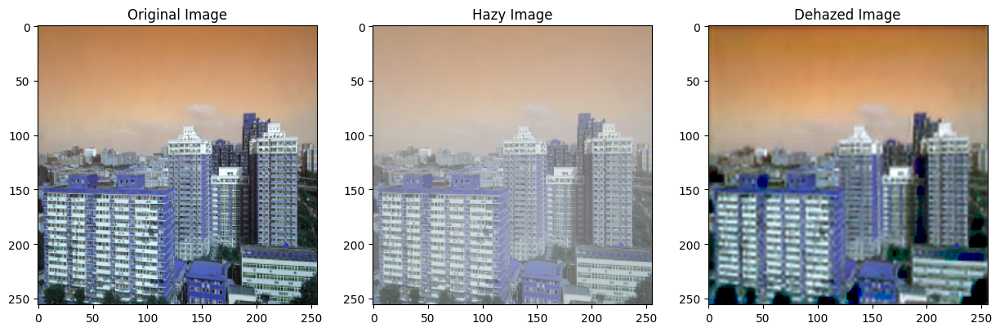

<Figure size 640x480 with 0 Axes>

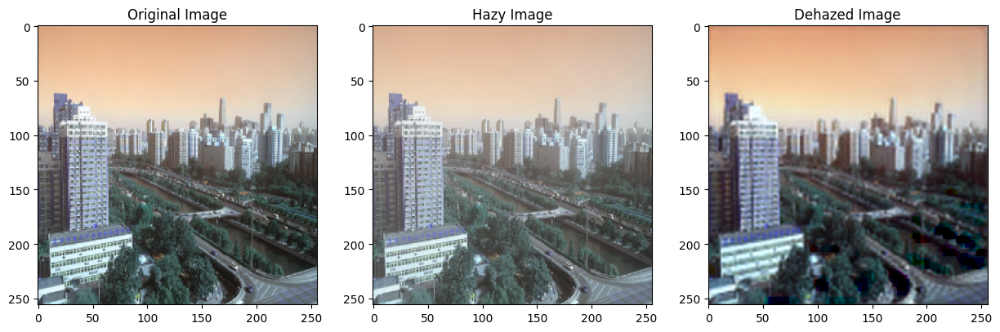

<Figure size 640x480 with 0 Axes>

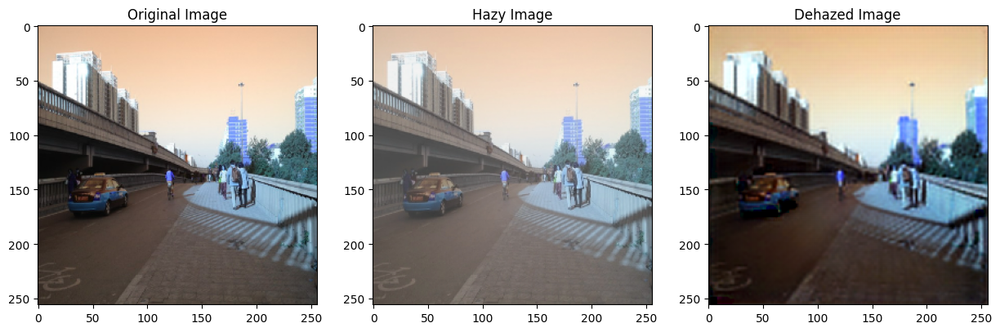

<Figure size 640x480 with 0 Axes>

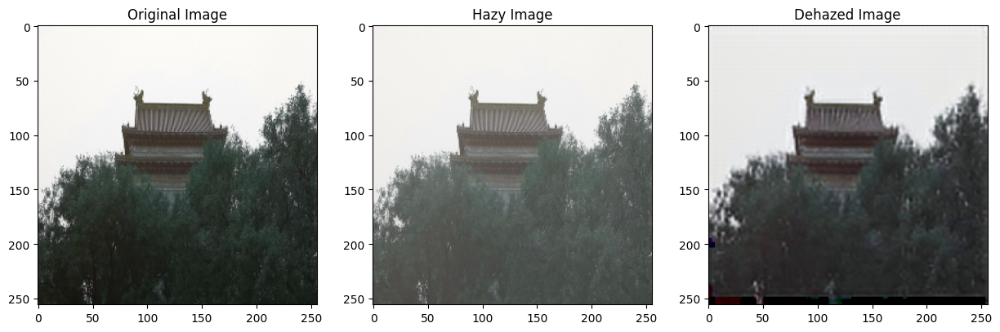

<Figure size 640x480 with 0 Axes>

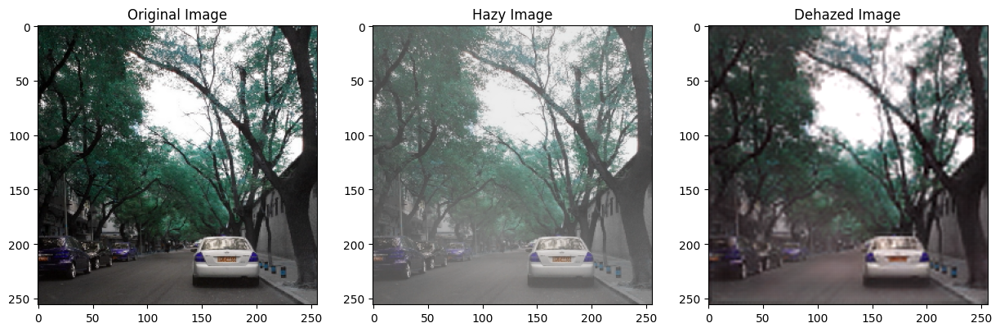

<Figure size 640x480 with 0 Axes>

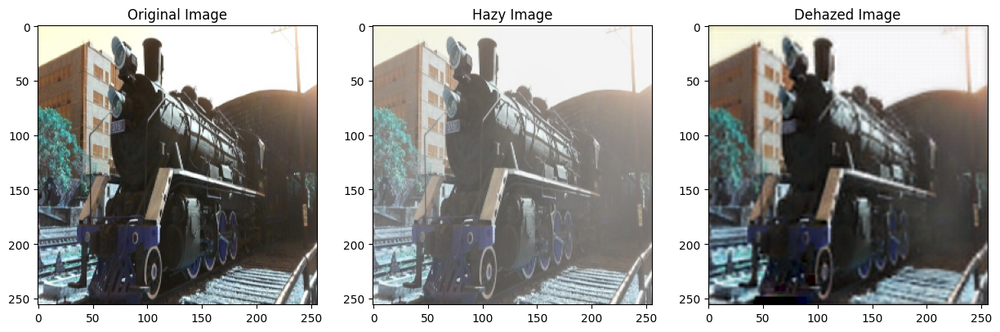

<Figure size 640x480 with 0 Axes>

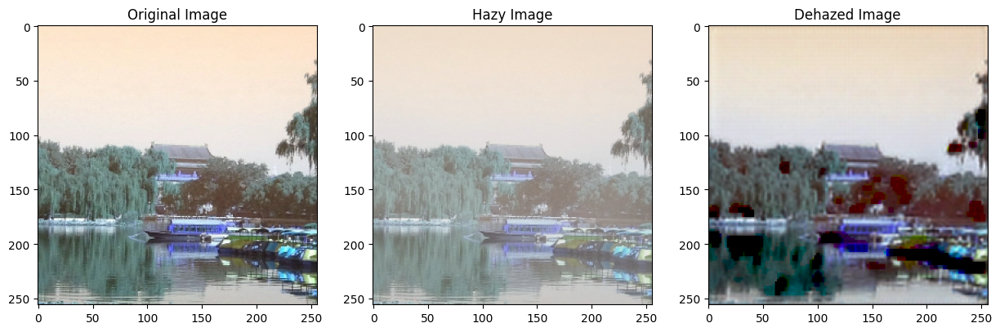

<Figure size 640x480 with 0 Axes>

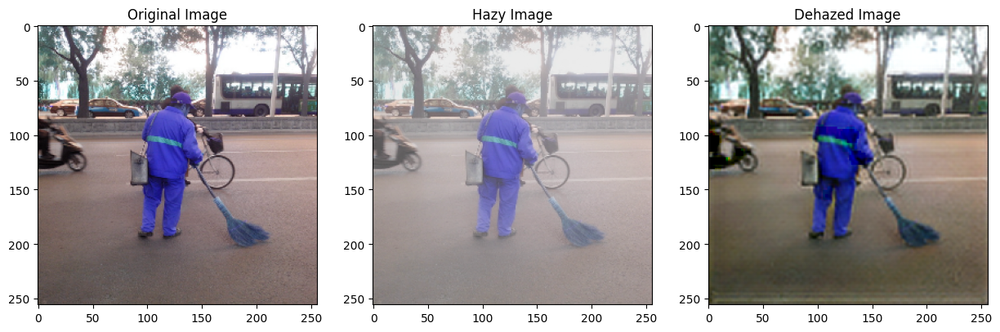

<Figure size 640x480 with 0 Axes>

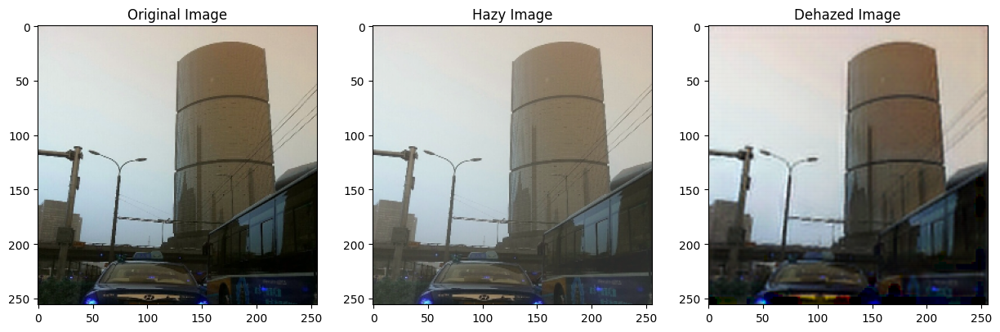

<Figure size 640x480 with 0 Axes>

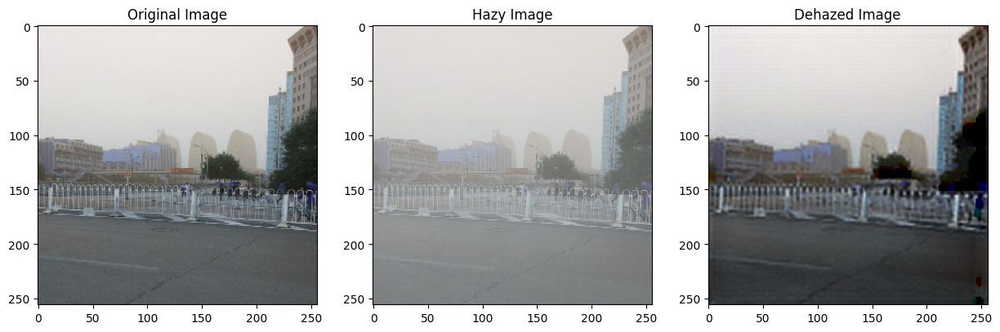

<Figure size 640x480 with 0 Axes>

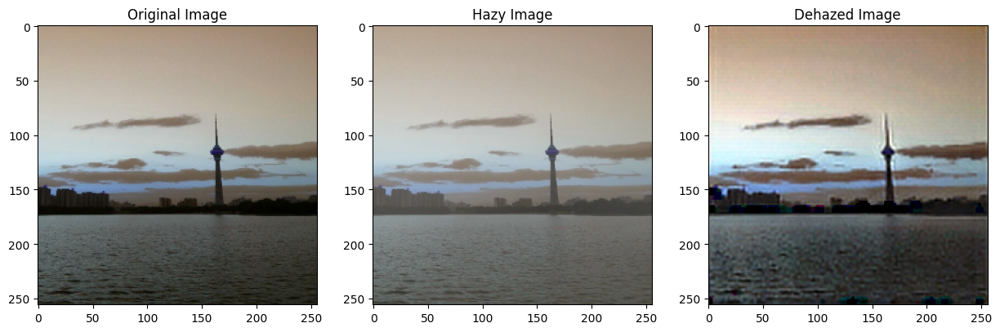

<Figure size 640x480 with 0 Axes>

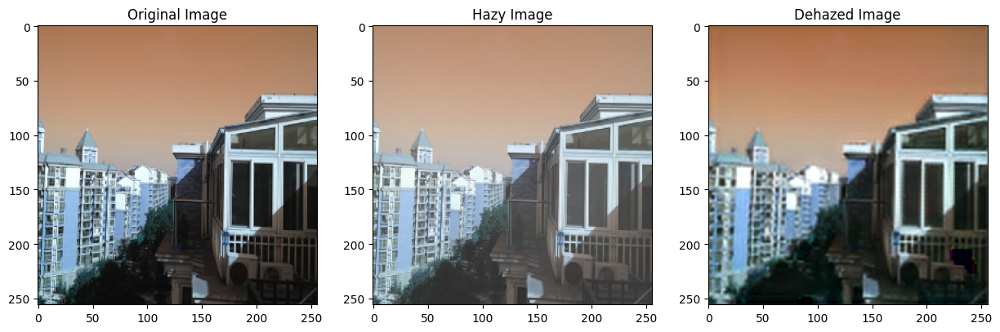

<Figure size 640x480 with 0 Axes>

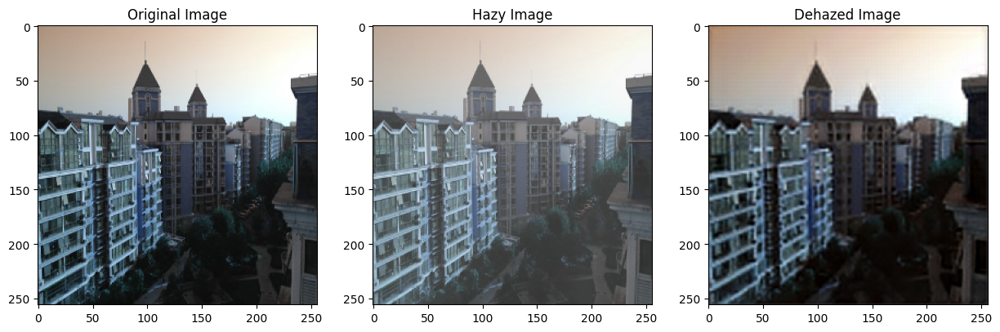

<Figure size 640x480 with 0 Axes>

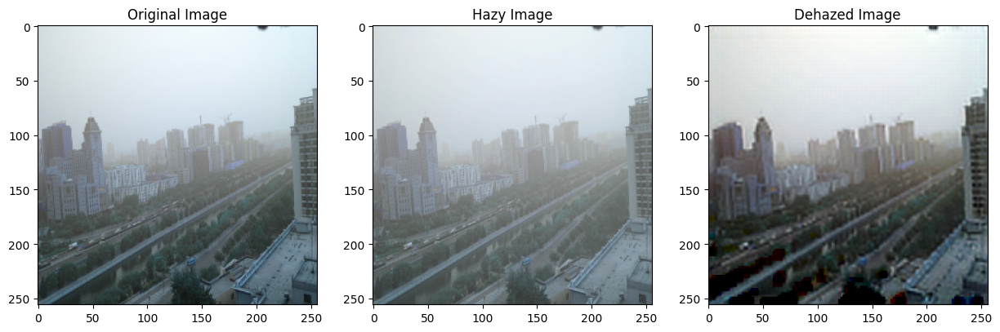

<Figure size 640x480 with 0 Axes>

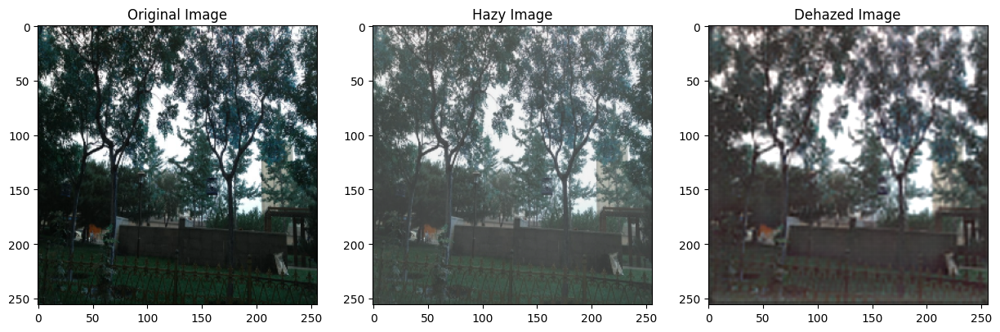

<Figure size 640x480 with 0 Axes>

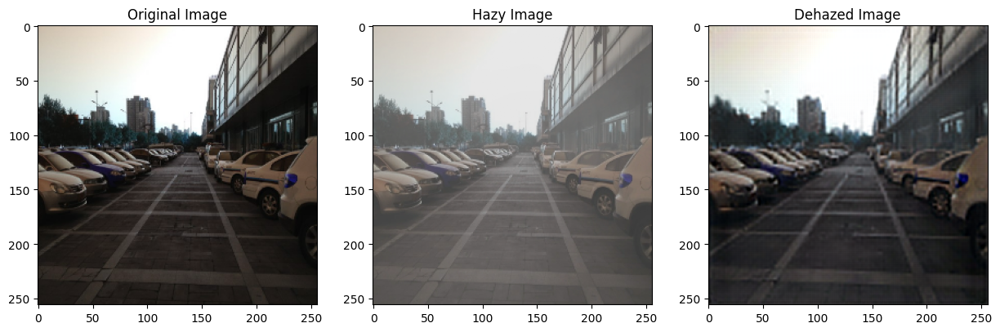

<Figure size 640x480 with 0 Axes>

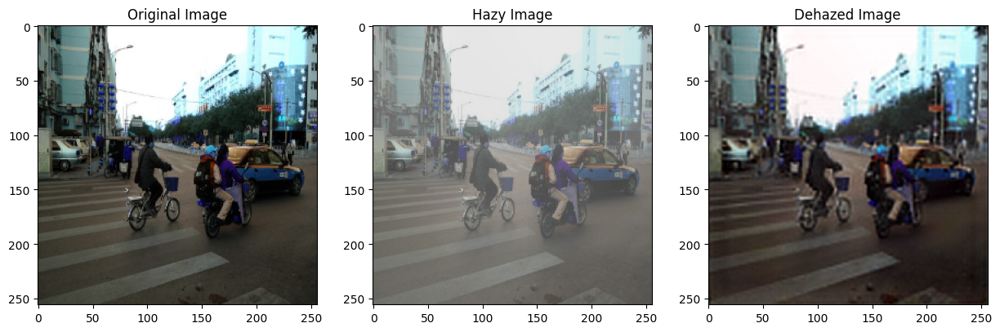

<Figure size 640x480 with 0 Axes>

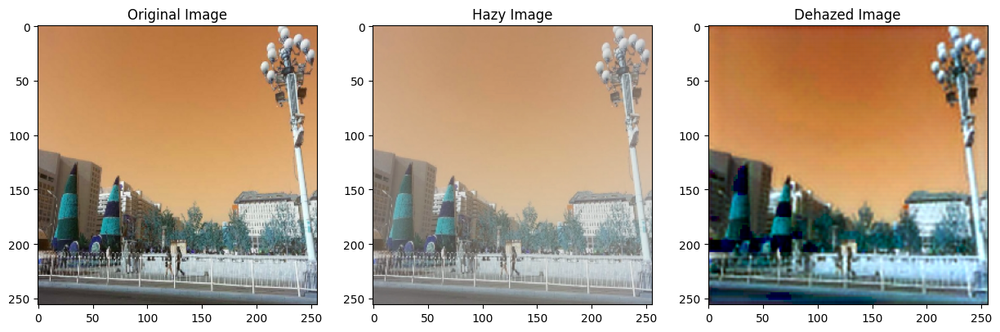

<Figure size 640x480 with 0 Axes>

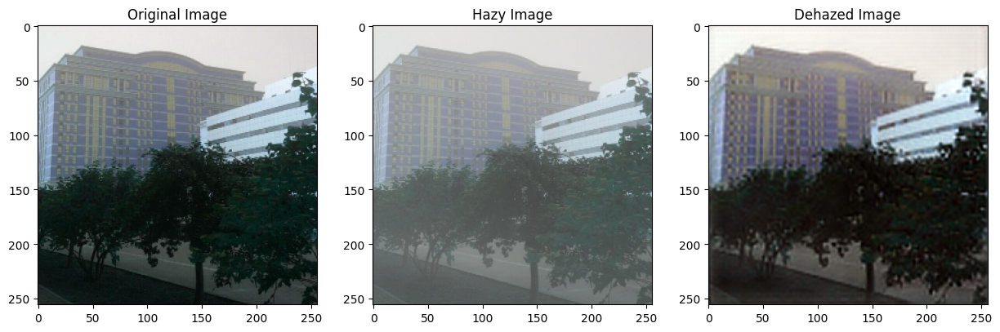

<Figure size 640x480 with 0 Axes>

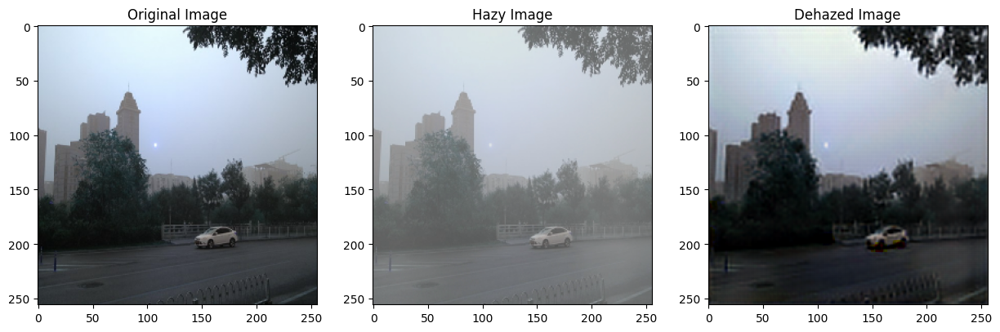

<Figure size 640x480 with 0 Axes>

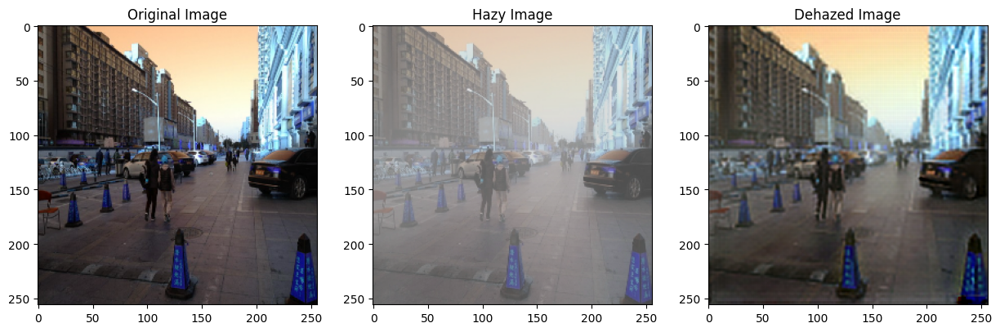

<Figure size 640x480 with 0 Axes>

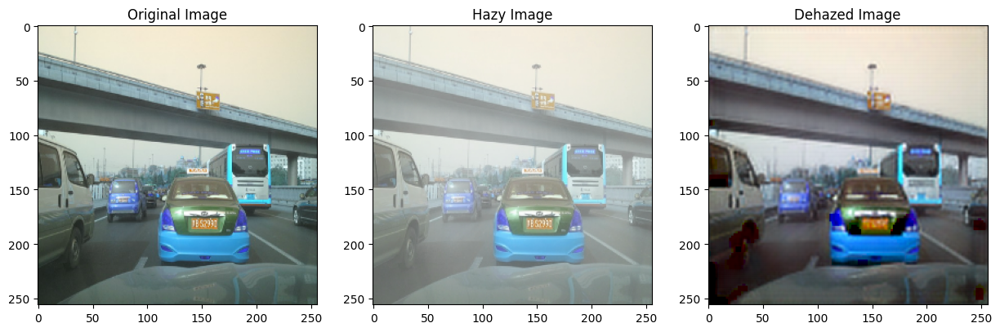

<Figure size 640x480 with 0 Axes>

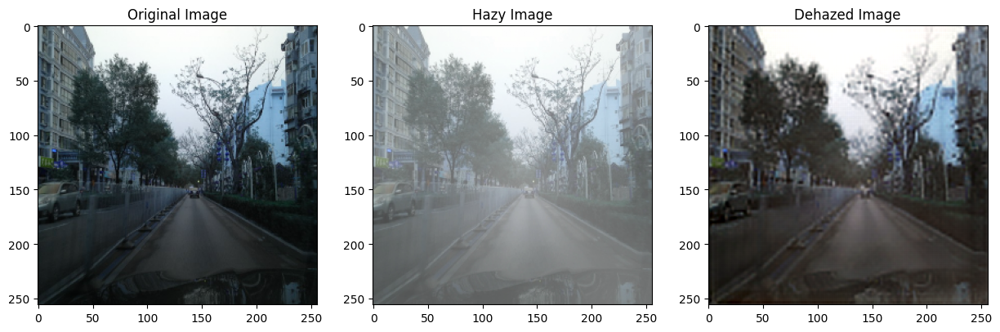

<Figure size 640x480 with 0 Axes>

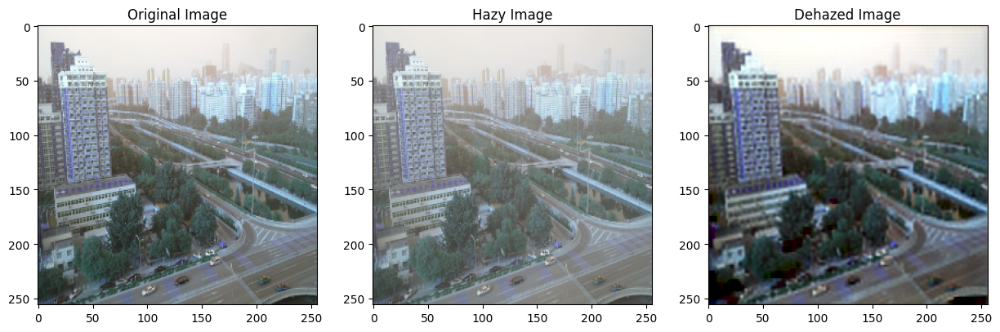

<Figure size 640x480 with 0 Axes>

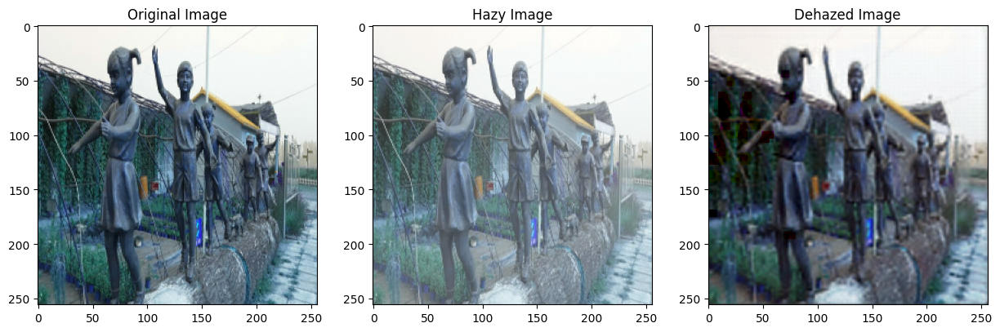

<Figure size 640x480 with 0 Axes>

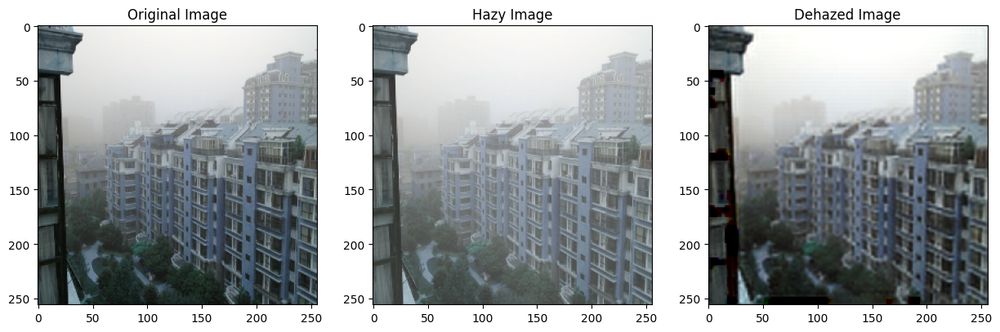

<Figure size 640x480 with 0 Axes>

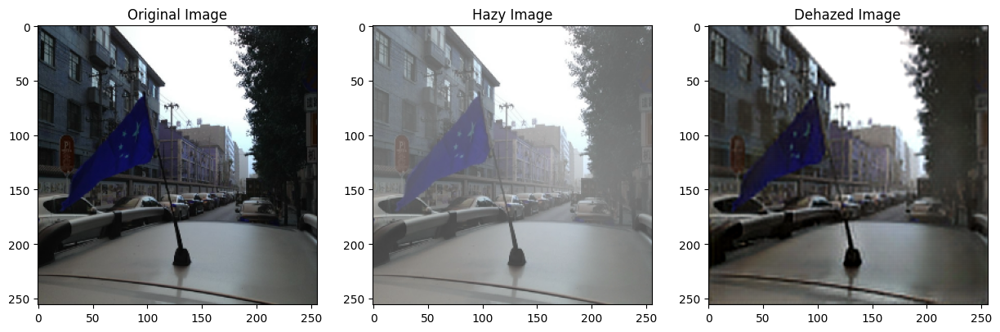

<Figure size 640x480 with 0 Axes>

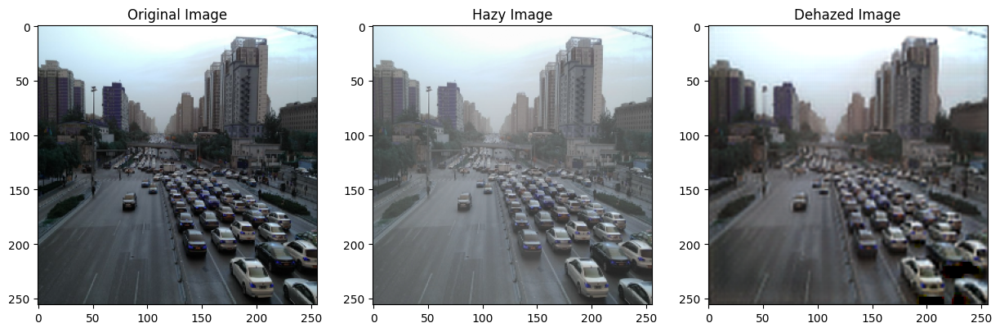

<Figure size 640x480 with 0 Axes>

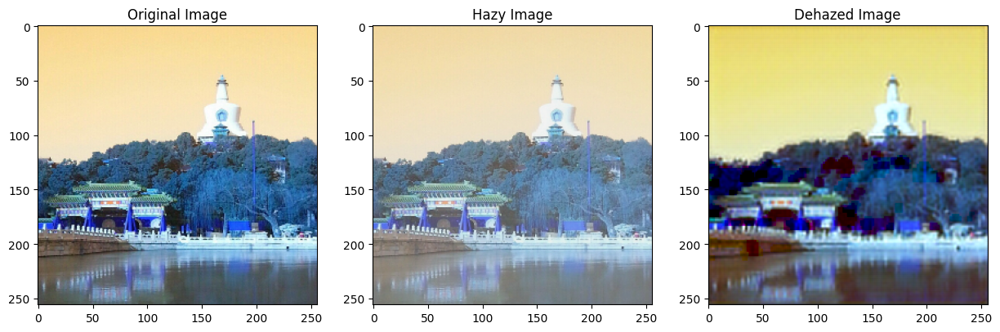

<Figure size 640x480 with 0 Axes>

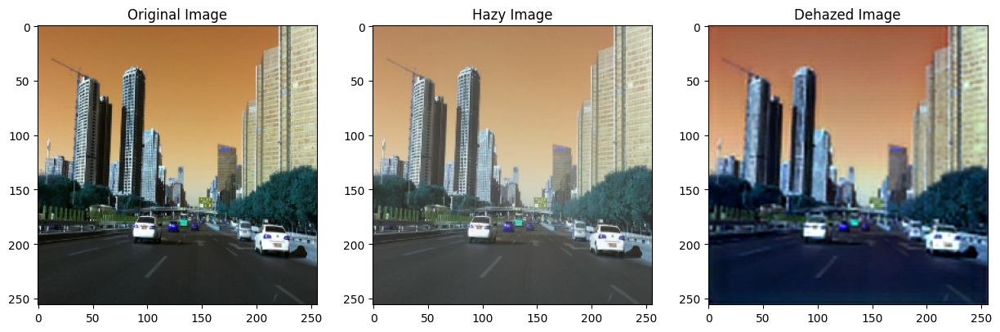

<Figure size 640x480 with 0 Axes>

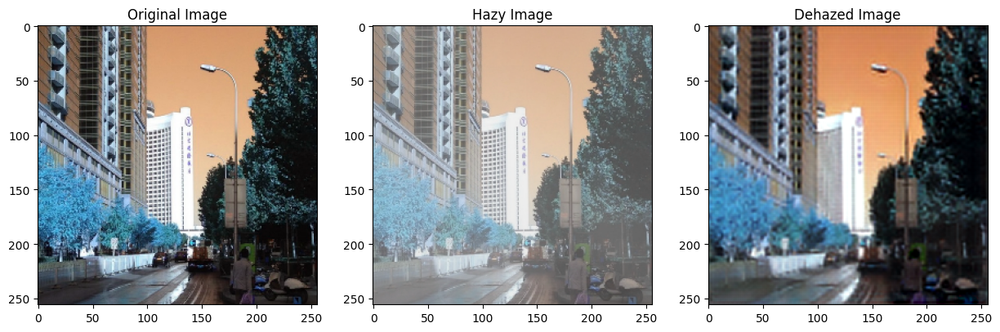

<Figure size 640x480 with 0 Axes>

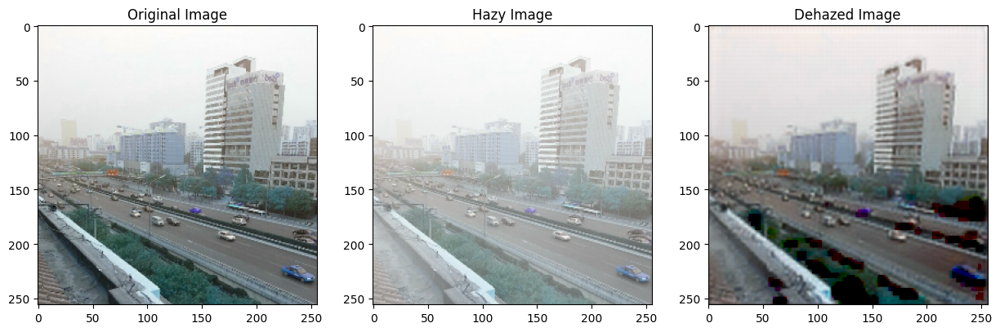

<Figure size 640x480 with 0 Axes>

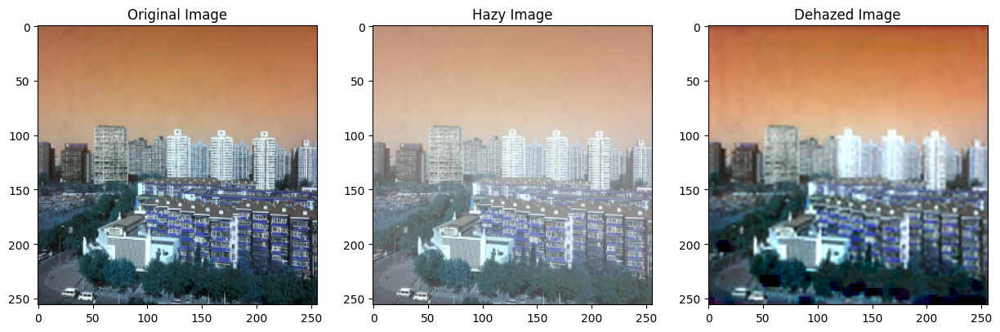

<Figure size 640x480 with 0 Axes>

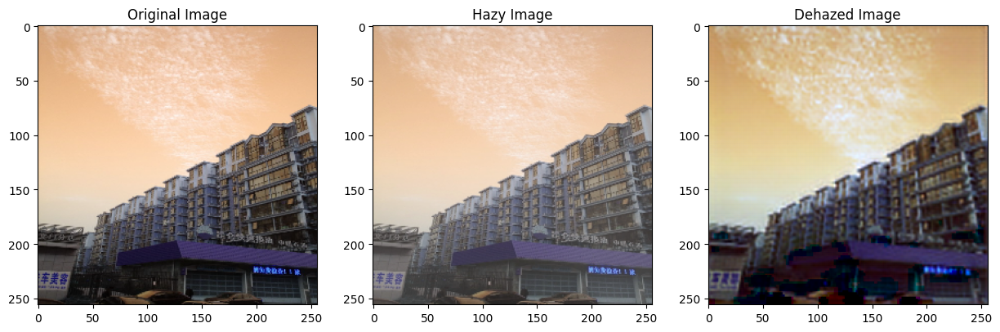

<Figure size 640x480 with 0 Axes>

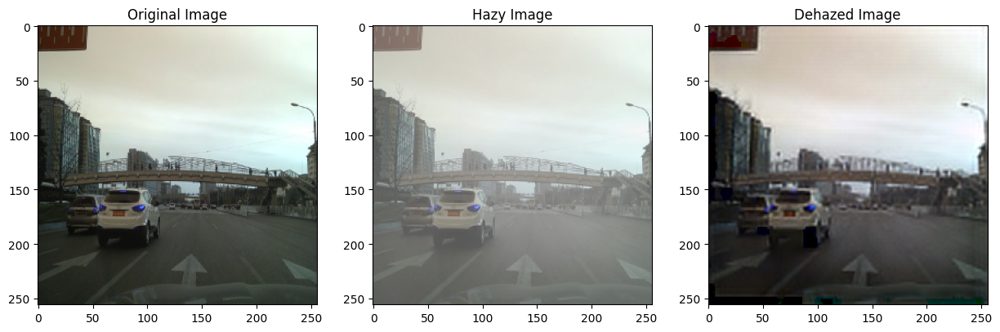

<Figure size 640x480 with 0 Axes>

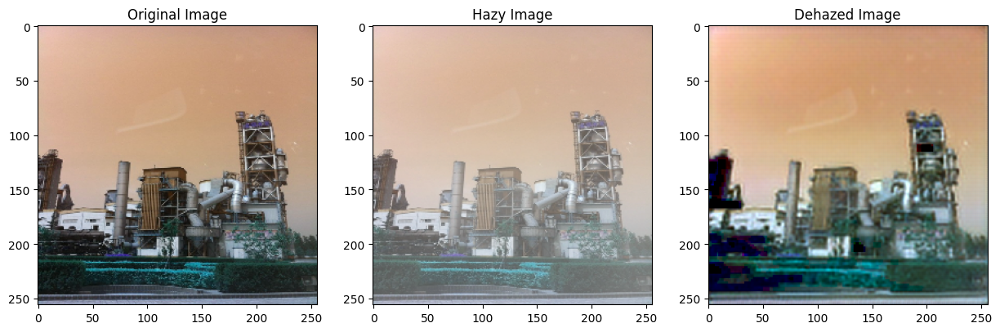

<Figure size 640x480 with 0 Axes>

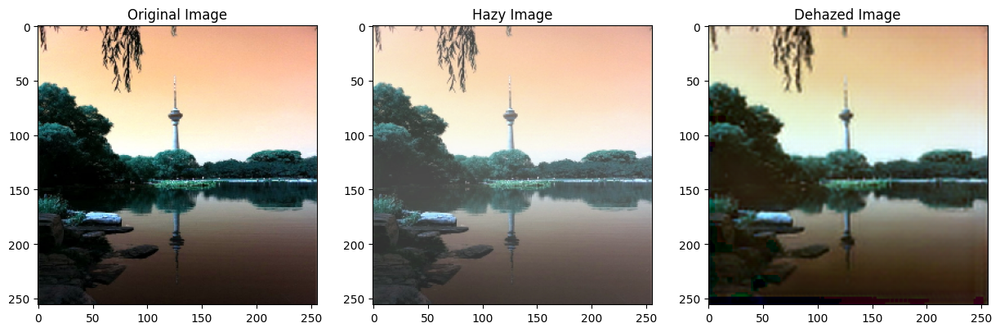

<Figure size 640x480 with 0 Axes>

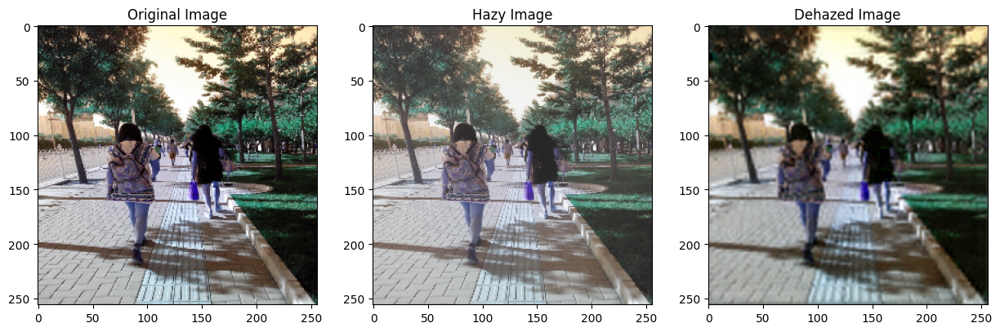

<Figure size 640x480 with 0 Axes>

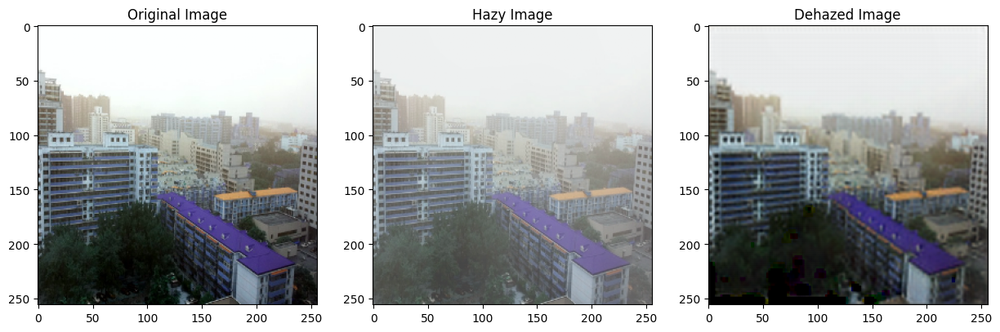

<Figure size 640x480 with 0 Axes>

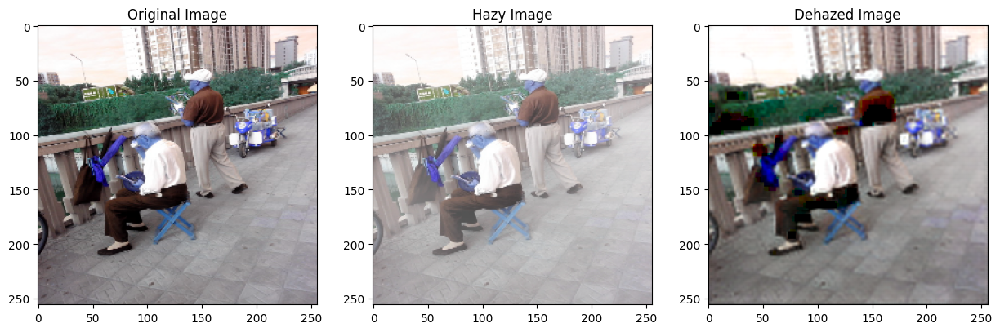

<Figure size 640x480 with 0 Axes>

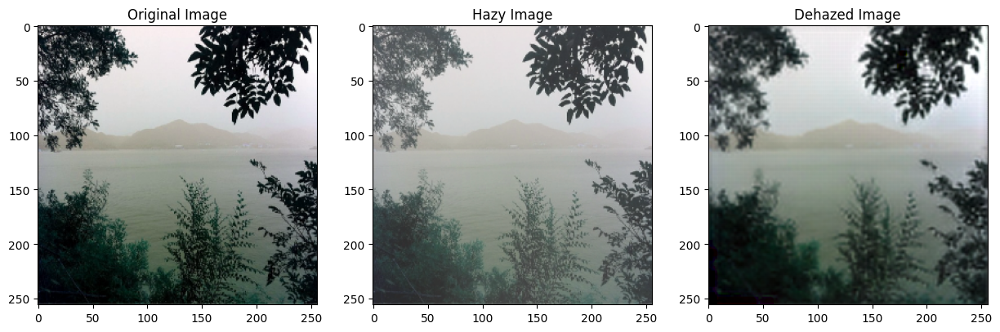

<Figure size 640x480 with 0 Axes>

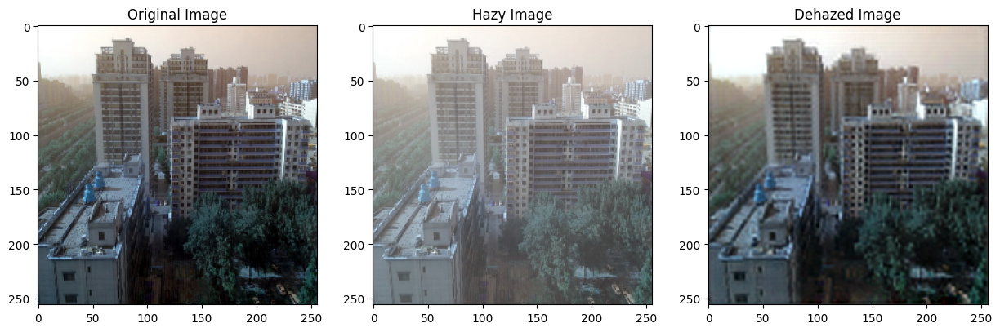

<Figure size 640x480 with 0 Axes>

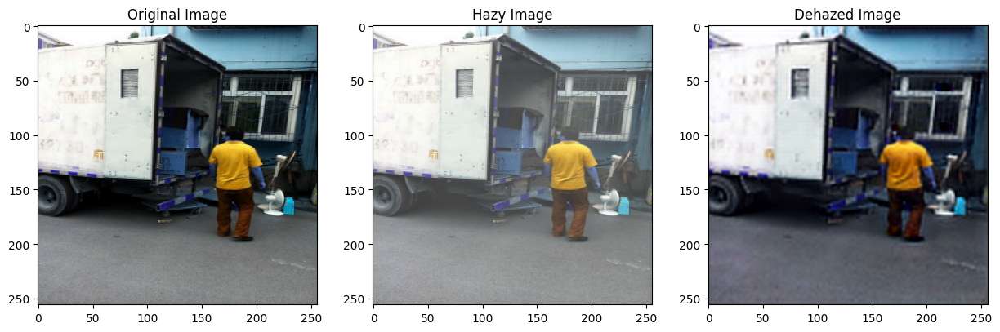

<Figure size 640x480 with 0 Axes>

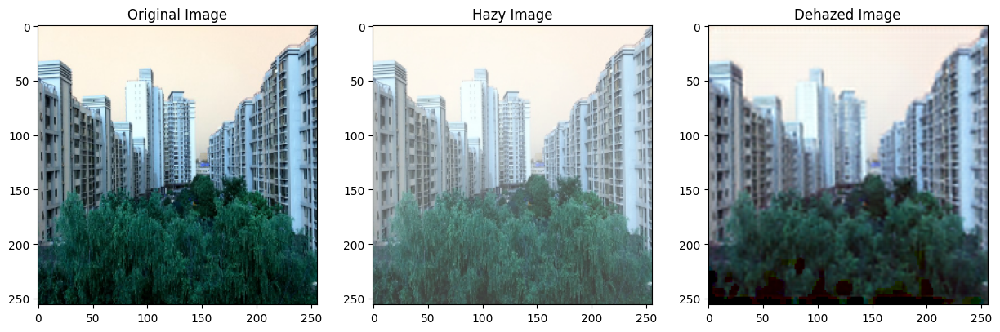

<Figure size 640x480 with 0 Axes>

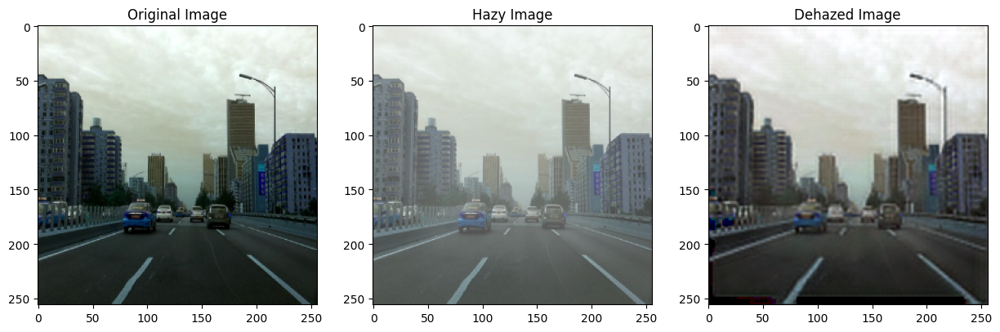

<Figure size 640x480 with 0 Axes>

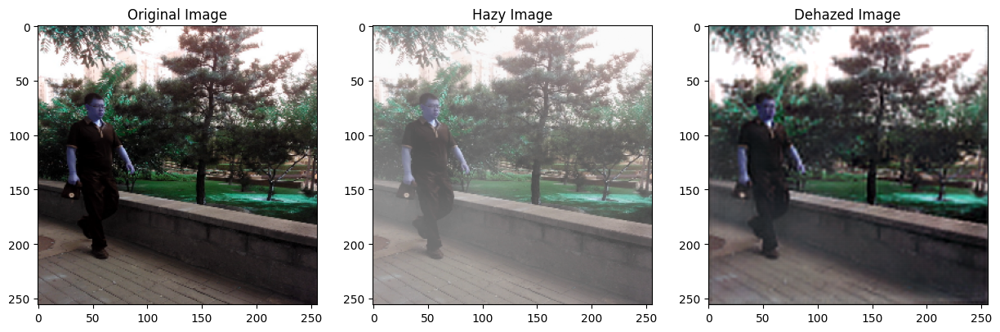

<Figure size 640x480 with 0 Axes>

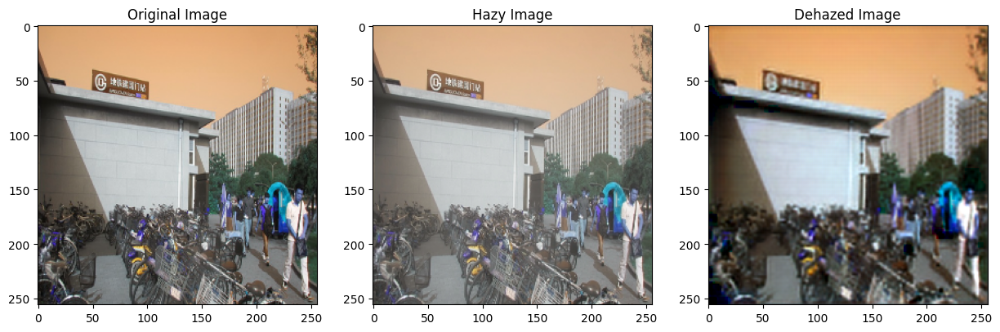

<Figure size 640x480 with 0 Axes>

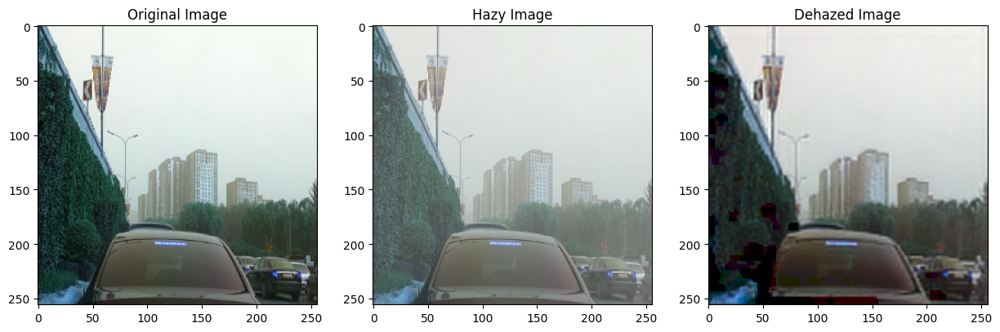

<Figure size 640x480 with 0 Axes>

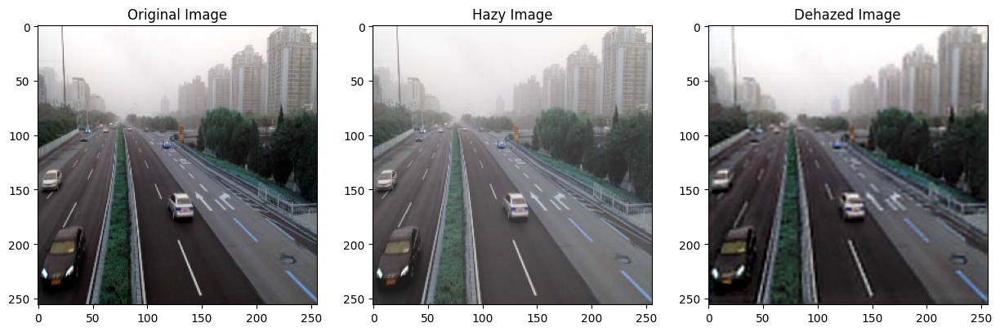

<Figure size 640x480 with 0 Axes>

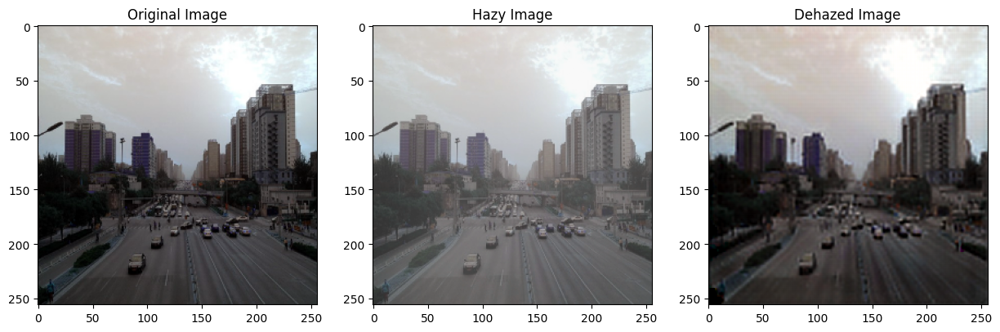

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in range(0,len(X_orig),10):

    fig=plt.figure(figsize=(15, 5))
    ax = plt.subplot(131)
    plt.title('Original Image')
    plt.imshow(X_orig[i])

    ax = plt.subplot(132)
    plt.title('Hazy Image')
    plt.imshow(X_hazy[i])

    ax = plt.subplot(133)
    plt.title('Dehazed Image')
    plt.imshow(X_dehazed[i])
    plt.show()
    plt.savefig('Result.png')

## **`EVALUATION`**

In [ ]:
X_dehazed=X_dehazed.numpy()
X_orig=X_orig.numpy()

X_orig=X_orig*255
X_dehazed=X_dehazed*255

ref_mat=X_orig
res_mat=X_dehazed

print(ref_mat.shape)
print(res_mat.shape)

(492, 256, 256, 3)
(492, 256, 256, 3)


In [ ]:
ref_mat = ref_mat.astype('float') / 255.0
res_mat = res_mat.astype('float') / 255.0

def output_psnr_mse(img_orig, img_out):
    squared_error = np.square(img_orig - img_out)
    mse = np.mean(squared_error)
    psnr = 10 * np.log10(1.0 / mse)
    return psnr

def mean_psnr_srgb(ref_mat, res_mat):
    n_blk, h, w, c = ref_mat.shape
    mean_psnr = 0
    for b in range(n_blk):
        ref_block = ref_mat[b, :, :, :]
        res_block = res_mat[b, :, :, :]
        ref_block = np.reshape(ref_block, (h, w, c))
        res_block = np.reshape(res_block, (h, w, c))
        psnr = output_psnr_mse(ref_block, res_block)
        mean_psnr += psnr
    return mean_psnr / n_blk

#PSNR
mean_psnr = mean_psnr_srgb(ref_mat, res_mat)
print('mean_psnr:')
print(mean_psnr)

mean_psnr:
62.10756841616737


In [ ]:
from skimage.metrics import structural_similarity as ssim

def mean_ssim_srgb(ref_mat, res_mat):
    n_blk, h, w, c = ref_mat.shape
    mean_ssim = 0
    for b in range(n_blk):
        ref_block = ref_mat[b, :, :, :]
        res_block = res_mat[b, :, :, :]
        ref_block = np.reshape(ref_block, (h, w, c))
        res_block = np.reshape(res_block, (h, w, c))
        ssim1 = ssim(ref_block, res_block, gaussian_weights=True, use_sample_covariance=False,
                     multichannel=True)
        mean_ssim += ssim1
    return mean_ssim / n_blk

# SSIM
mean_ssim = mean_ssim_srgb(ref_mat, res_mat)
print('mean_ssim:')
print(mean_ssim)

<ipython-input-90-c3747387b4c0>:11: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim1 = ssim(ref_block, res_block, gaussian_weights=True, use_sample_covariance=False,


mean_ssim:
0.7757909044254135


## **`TESTING`**

Testing on random images taken from google

In [ ]:
test_path='/content/drive/MyDrive/test'

X_test=[]
files = os.listdir(test_path)
for f in tqdm(files):
    path = os.path.join(test_path,f)
    img = cv2.imread(path)
    try:
      img = cv2.resize(img,(IMG_SIZE,IMG_SIZE))
    except:
      pass
    X_test.append(np.array(img))
print(X_test)

In [ ]:
X_test = torch.FloatTensor(X_test)

X_test = X_test/255

X_test_orig = X_test
print(X_test_orig.shape)

torch.Size([12, 256, 256, 3])


In [ ]:
X_test = X_test.permute(0,3,1,2)
X_test = X_test.reshape(-1,1,IMG_SIZE,IMG_SIZE)
X_test.size()

torch.Size([36, 1, 256, 256])

In [ ]:
test_img_loader = torch.utils.data.DataLoader(dataset=X_test,batch_size=batch_size,shuffle=False)

dehazed_output=[]
for test_img in test_img_loader:
    hazy_image = Variable(test_img).cuda()

    encoder_op = encoder(hazy_image)
    output = decoder(encoder_op)

    output=output.cpu()
    output=output.detach()
    dehazed_output.append(output)

In [ ]:
IMG_SIZE_2=256
X_dehazed=dehazed_output
X_dehazed=torch.stack(X_dehazed)

print(X_dehazed.size())

X_dehazed=X_dehazed.view(-1,1,IMG_SIZE_2,IMG_SIZE_2)

print(X_dehazed.size())

X_dehazed=X_dehazed.view(-1,3,IMG_SIZE_2,IMG_SIZE_2)
print(X_dehazed.size())

X_dehazed=X_dehazed.permute(0,2,3,1)
print(X_dehazed.shape)

torch.Size([36, 1, 1, 256, 256])
torch.Size([36, 1, 256, 256])
torch.Size([12, 3, 256, 256])
torch.Size([12, 256, 256, 3])


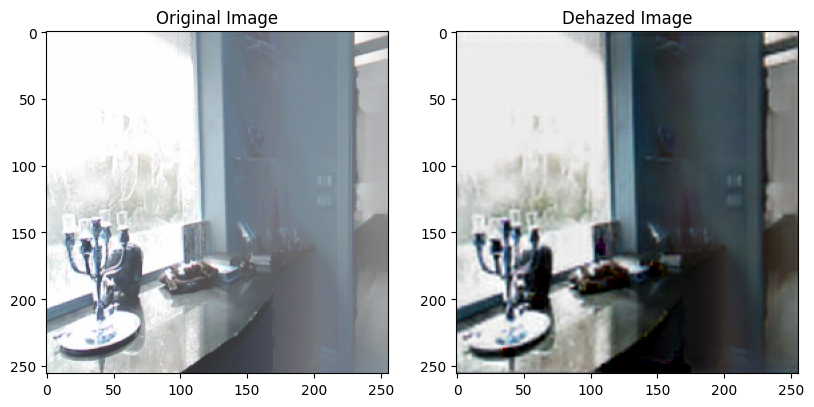

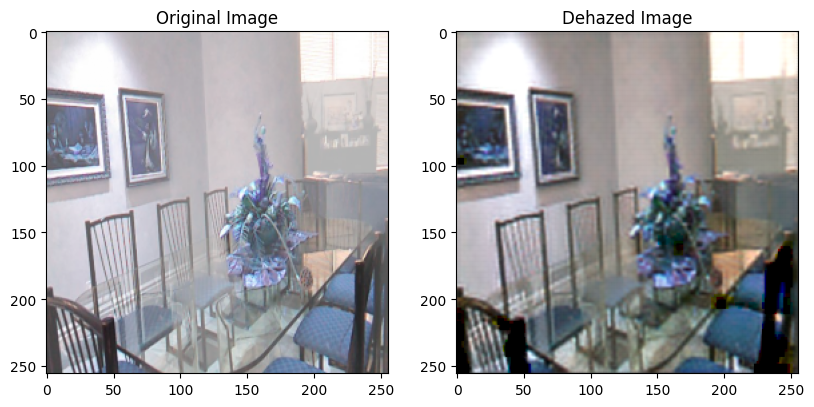

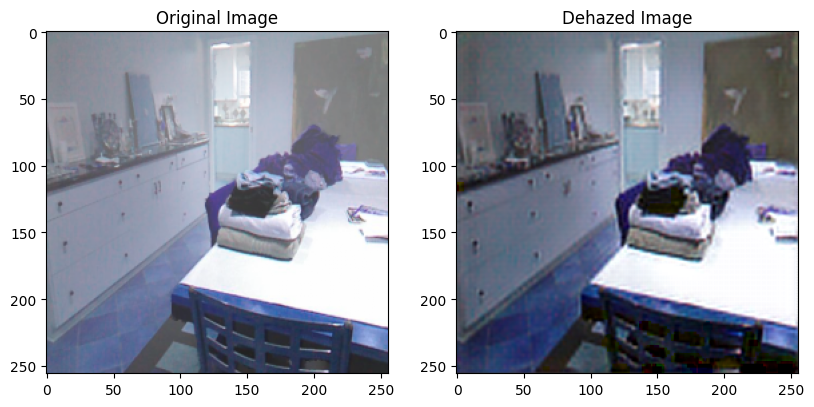

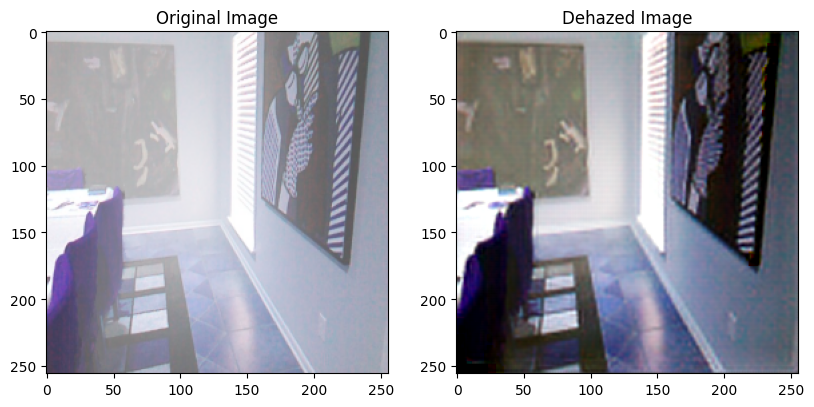

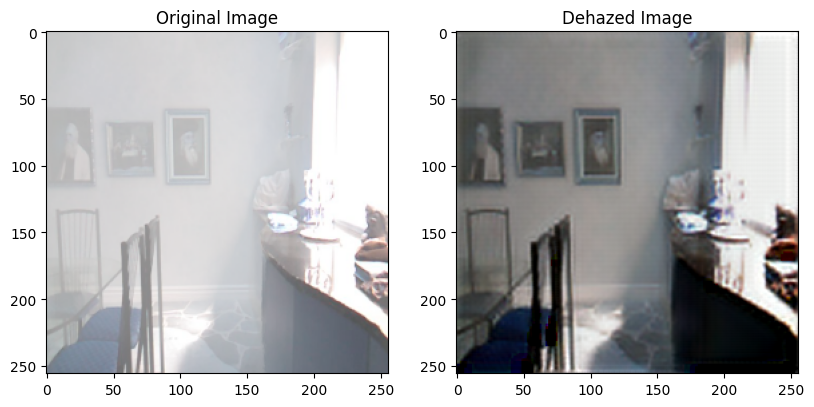

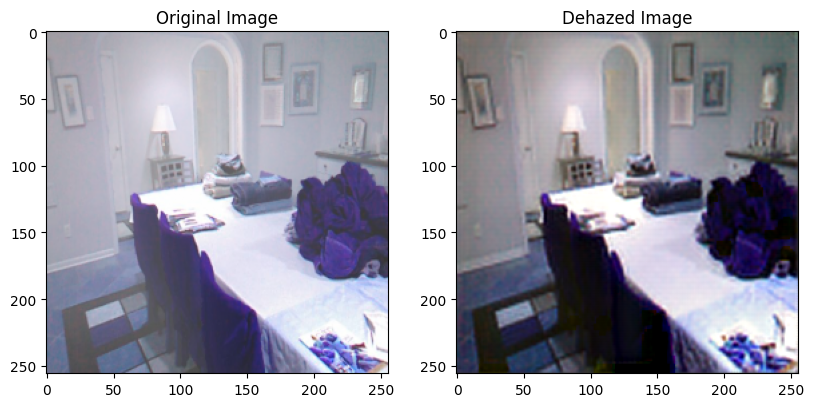

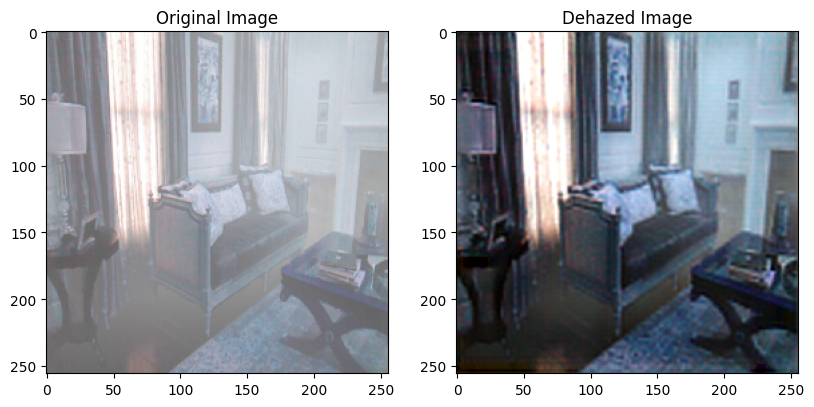

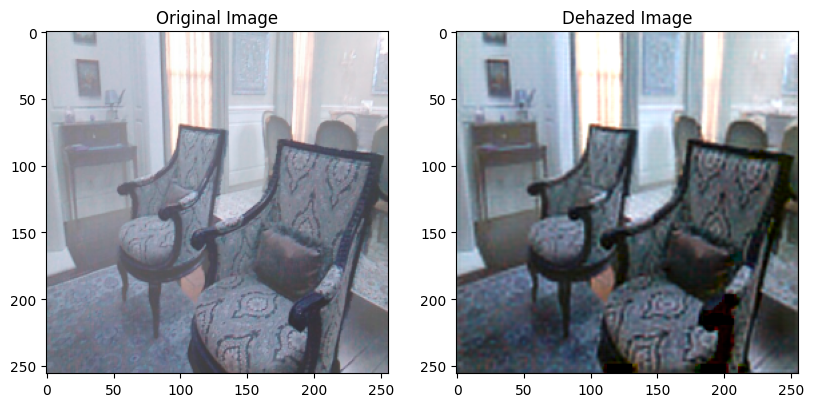

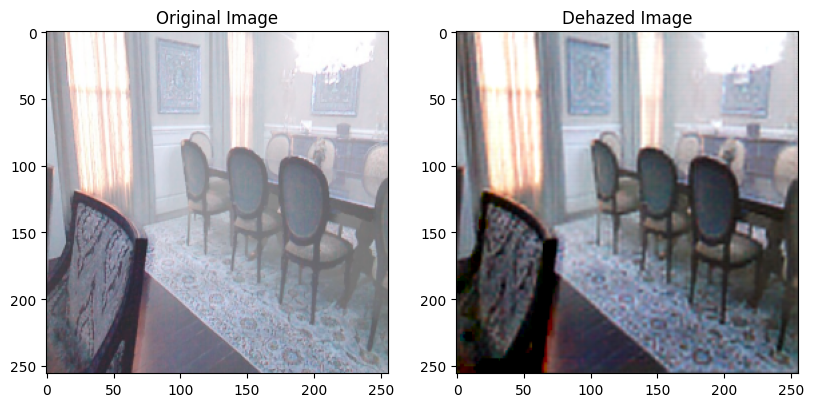

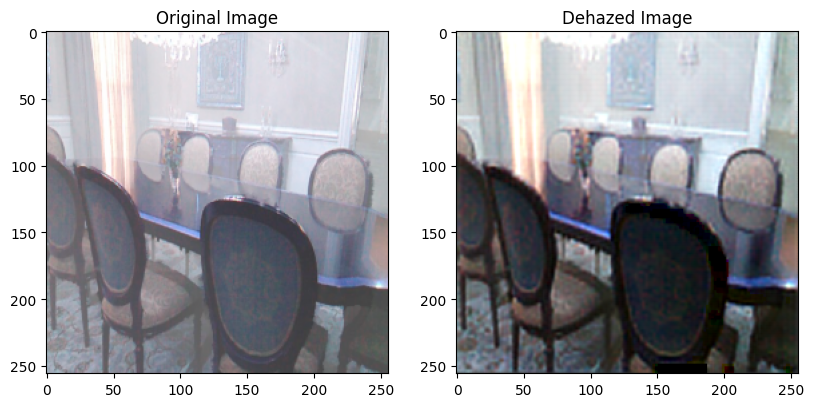

In [ ]:
for i in range(0,10):
    #len(X_test_orig)
    fig=plt.figure(figsize=(15, 5))
    ax = plt.subplot(131)
    plt.title('Original Image')
    plt.imshow(X_test_orig[i])

    ax = plt.subplot(132)
    plt.title('Dehazed Image')
    plt.imshow(X_dehazed[i])
    plt.show()

In [ ]:
X_test_orig = X_test_orig.numpy()
X_dehazed = X_dehazed.numpy()

X_test_orig=X_test_orig*255
X_dehazed=X_dehazed*255

ref_mat=X_test_orig
res_mat=X_dehazed

ref_mat = ref_mat.astype('float') / 255.0
res_mat = res_mat.astype('float') / 255.0

#PSNR
mean_psnr = mean_psnr_srgb(ref_mat, res_mat)
print('mean_psnr:')
print(mean_psnr)

# SSIM
mean_ssim = mean_ssim_srgb(ref_mat, res_mat)
print('mean_ssim:')
print(mean_ssim)

mean_psnr:
13.976764769112954


<ipython-input-90-c3747387b4c0>:11: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim1 = ssim(ref_block, res_block, gaussian_weights=True, use_sample_covariance=False,


mean_ssim:
0.7757909029151145


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Apr 10 07:30:53 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    52W / 400W |   2253MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------